In [1]:
%load_ext autoreload
%autoreload 2
%env WANDB_SILENT=true

env: WANDB_SILENT=true


In [2]:
import torch
from torchmetrics.image import PeakSignalNoiseRatio, StructuralSimilarityIndexMeasure, LearnedPerceptualImagePatchSimilarity
import utils
from models import UNetMod
from denoisers.dip import DIP, DDIP, SGDIP, losses, schedules

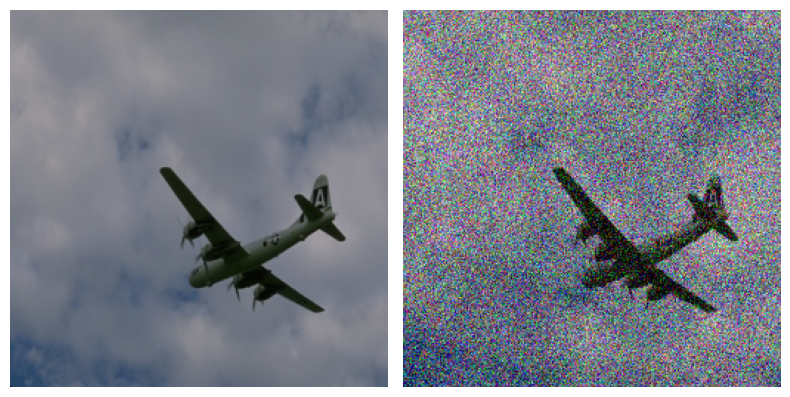

tensor(14.9970)


In [3]:
# clean = utils.load_celeba(30)
clean = utils.load_images('./data/CBSD68/')[:20]
# clean = utils.load_images('./data/Set14/')
# clean = utils.load_image("./data/set5/butterfly.png")
noisy = torch.stack([utils.get_noisy_image(img, 15) for img in clean])

utils.plot_row([clean[0], noisy[0]])

psnr = PeakSignalNoiseRatio(data_range=2)
print(psnr(noisy, clean))

In [4]:
# networks
net = UNetMod(hidden_ch=8, n_layers=4)

# losses
mse_ae = losses.Composed(losses.MSE(), losses.AE())
nmse_ae = losses.Composed(losses.NMSE(), losses.AE())

mse_tv = losses.Composed(losses.MSE(), losses.TV())
nmse_tv = losses.Composed(losses.NMSE(), losses.TV())

# variants
dip = DIP(net, losses.MSE())
dip_es = DIP(net, losses.MSE(), early_stopping=True)
dip_neighbor = DIP(net, losses.NMSE())
dip_neighbor_es = DIP(net, losses.NMSE(), early_stopping=True)
dip_tv = DIP(net, mse_tv)
dip_tv_es = DIP(net, mse_tv, early_stopping=True)

sgdip = SGDIP(net, mse_ae)
sgdip_es = SGDIP(net, mse_ae, early_stopping=True)
sgdip_neighbor = SGDIP(net, nmse_ae)
sgdip_neighbor_es = SGDIP(net, nmse_ae, early_stopping=True)

ddip = DDIP(net, losses.MSE(), schedules.Cos(0.1))
ddip_neighbor = DDIP(net, losses.NMSE(), schedules.Cos(0.1))

In [5]:
denoisers = [
    # SGDIP(net, mse_ae.with_alpha(0)),
    # SGDIP(net, mse_ae.with_alpha(0.1)),
    # SGDIP(net, mse_ae.with_alpha(1)),
    sgdip_es,
    SGDIP(net, mse_ae.with_alpha(schedules.Linear(1, 10))),
    dip_es,
    ddip,
]

metrics = {
    "psnr": PeakSignalNoiseRatio(data_range=2),
    "ssim": StructuralSimilarityIndexMeasure(data_range=2),
}

results = {}
for i, denoiser in enumerate(denoisers):
    outputs = []
    for j, (x_hat, x) in enumerate(zip(noisy, clean)):
        options = {
            "mode": "wandb",
            "config": {
                "project": "zero-shot-das-denoising",
                "entity": "jmaen-team",
                "group": "sgdip schedule 1",
                "dataset": "cbsd68-15",
                "denoiser_id": i,
                "data_id": j,
            },
            "metrics": metrics,
            "log_output": False,
        }
        output = denoiser.denoise(x_hat.unsqueeze(0), x.unsqueeze(0), options)
        output = output.detach().clone().cpu()
        outputs.append(output)

    results[f"{i} - {denoiser.name()}"] = torch.cat(outputs)

Running: 0 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 94%|█████████▎| 1870/2000 [03:08<00:13,  9.94it/s]


Running: 1 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 56%|█████▌    | 1111/2000 [01:48<01:26, 10.24it/s]


Running: 2 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


100%|██████████| 2000/2000 [03:12<00:00, 10.39it/s]


Running: 3 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 69%|██████▉   | 1377/2000 [02:13<01:00, 10.32it/s]


Running: 4 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 58%|█████▊    | 1154/2000 [01:50<01:21, 10.41it/s]


Running: 5 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 70%|██████▉   | 1394/2000 [02:16<00:59, 10.19it/s]


Running: 6 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 60%|██████    | 1203/2000 [01:58<01:18, 10.15it/s]


Running: 7 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 46%|████▌     | 923/2000 [01:28<01:43, 10.39it/s]


Running: 8 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 58%|█████▊    | 1169/2000 [01:53<01:20, 10.34it/s]


Running: 9 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 71%|███████   | 1418/2000 [02:17<00:56, 10.33it/s]


Running: 10 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 67%|██████▋   | 1338/2000 [02:09<01:03, 10.35it/s]


Running: 11 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 59%|█████▉    | 1180/2000 [01:54<01:19, 10.30it/s]


Running: 12 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 68%|██████▊   | 1351/2000 [02:11<01:02, 10.30it/s]


Running: 13 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 77%|███████▋  | 1537/2000 [02:28<00:44, 10.35it/s]


Running: 14 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 60%|█████▉    | 1196/2000 [01:56<01:18, 10.26it/s]


Running: 15 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 57%|█████▋    | 1132/2000 [01:54<01:27,  9.93it/s]


Running: 16 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 58%|█████▊    | 1168/2000 [01:58<01:24,  9.82it/s]


Running: 17 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 83%|████████▎ | 1651/2000 [02:39<00:33, 10.37it/s]


Running: 18 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 56%|█████▋    | 1130/2000 [01:49<01:24, 10.34it/s]


Running: 19 - SGDIP - ES (k=3, r=0.5) - MSE + AE (alpha=1) - UNetMod 


 65%|██████▌   | 1305/2000 [02:06<01:07, 10.34it/s]


Running: 0 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:10<00:00, 10.48it/s]


Running: 1 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:11<00:00, 10.42it/s]


Running: 2 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:11<00:00, 10.42it/s]


Running: 3 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:12<00:00, 10.38it/s]


Running: 4 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:11<00:00, 10.46it/s]


Running: 5 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:11<00:00, 10.46it/s]


Running: 6 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:12<00:00, 10.39it/s]


Running: 7 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:19<00:00, 10.03it/s]


Running: 8 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:18<00:00, 10.07it/s]


Running: 9 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:10<00:00, 10.52it/s]


Running: 10 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:06<00:00, 10.72it/s]


Running: 11 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:09<00:00, 10.55it/s]


Running: 12 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:11<00:00, 10.46it/s]


Running: 13 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:10<00:00, 10.47it/s]


Running: 14 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:10<00:00, 10.50it/s]


Running: 15 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:12<00:00, 10.41it/s]


Running: 16 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:16<00:00, 10.16it/s]


Running: 17 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:16<00:00, 10.16it/s]


Running: 18 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:13<00:00, 10.33it/s]


Running: 19 - SGDIP (k=3, r=0.5) - MSE + AE (alpha=Linear) - UNetMod 


100%|██████████| 2000/2000 [03:10<00:00, 10.50it/s]


Running: 0 - DIP - ES - MSE - UNetMod 


 36%|███▌      | 715/2000 [00:26<00:48, 26.60it/s]


Running: 1 - DIP - ES - MSE - UNetMod 


 54%|█████▎    | 1072/2000 [00:39<00:33, 27.33it/s]


Running: 2 - DIP - ES - MSE - UNetMod 


 46%|████▌     | 921/2000 [00:34<00:39, 27.07it/s]


Running: 3 - DIP - ES - MSE - UNetMod 


 49%|████▉     | 985/2000 [00:36<00:37, 27.07it/s]


Running: 4 - DIP - ES - MSE - UNetMod 


 43%|████▎     | 853/2000 [00:32<00:44, 25.91it/s]


Running: 5 - DIP - ES - MSE - UNetMod 


 44%|████▍     | 878/2000 [00:32<00:41, 27.10it/s]


Running: 6 - DIP - ES - MSE - UNetMod 


 51%|█████     | 1016/2000 [00:36<00:35, 27.82it/s]


Running: 7 - DIP - ES - MSE - UNetMod 


 56%|█████▌    | 1114/2000 [00:40<00:31, 27.75it/s]


Running: 8 - DIP - ES - MSE - UNetMod 


 52%|█████▏    | 1040/2000 [00:37<00:35, 27.39it/s]


Running: 9 - DIP - ES - MSE - UNetMod 


 46%|████▌     | 918/2000 [00:33<00:39, 27.05it/s]


Running: 10 - DIP - ES - MSE - UNetMod 


 44%|████▍     | 889/2000 [00:32<00:40, 27.13it/s]


Running: 11 - DIP - ES - MSE - UNetMod 


 41%|████      | 815/2000 [00:29<00:42, 27.90it/s]


Running: 12 - DIP - ES - MSE - UNetMod 


 38%|███▊      | 761/2000 [00:29<00:48, 25.60it/s]


Running: 13 - DIP - ES - MSE - UNetMod 


 45%|████▍     | 894/2000 [00:32<00:40, 27.10it/s]


Running: 14 - DIP - ES - MSE - UNetMod 


 41%|████      | 812/2000 [00:29<00:43, 27.21it/s]


Running: 15 - DIP - ES - MSE - UNetMod 


 40%|███▉      | 798/2000 [00:29<00:44, 27.06it/s]


Running: 16 - DIP - ES - MSE - UNetMod 


 52%|█████▏    | 1030/2000 [00:38<00:35, 27.06it/s]


Running: 17 - DIP - ES - MSE - UNetMod 


 46%|████▌     | 914/2000 [00:33<00:39, 27.18it/s]


Running: 18 - DIP - ES - MSE - UNetMod 


 57%|█████▋    | 1136/2000 [00:41<00:31, 27.32it/s]


Running: 19 - DIP - ES - MSE - UNetMod 


 42%|████▏     | 845/2000 [00:37<00:50, 22.82it/s]


Running: 0 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:13<00:00, 27.17it/s]


Running: 1 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:12<00:00, 27.59it/s]


Running: 2 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:16<00:00, 26.24it/s]


Running: 3 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:13<00:00, 27.29it/s]


Running: 4 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:12<00:00, 27.50it/s]


Running: 5 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:12<00:00, 27.61it/s]


Running: 6 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:12<00:00, 27.60it/s]


Running: 7 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:12<00:00, 27.74it/s]


Running: 8 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:11<00:00, 28.11it/s]


Running: 9 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:11<00:00, 28.02it/s]


Running: 10 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:12<00:00, 27.77it/s]


Running: 11 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:12<00:00, 27.75it/s]


Running: 12 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:11<00:00, 27.78it/s]


Running: 13 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:11<00:00, 27.84it/s]


Running: 14 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:11<00:00, 27.78it/s]


Running: 15 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:11<00:00, 27.81it/s]


Running: 16 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:12<00:00, 27.59it/s]


Running: 17 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:12<00:00, 27.75it/s]


Running: 18 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:12<00:00, 27.68it/s]


Running: 19 - DDIP (Cos) - MSE - UNetMod 


100%|██████████| 2000/2000 [01:12<00:00, 27.67it/s]


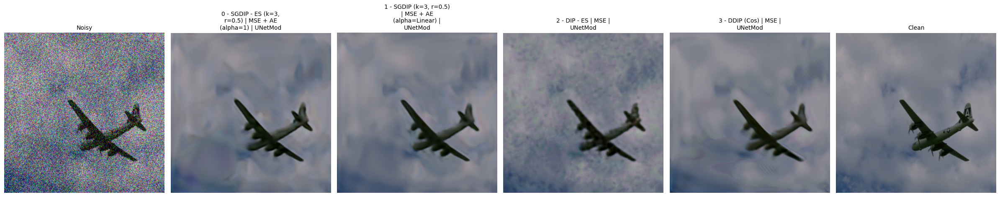

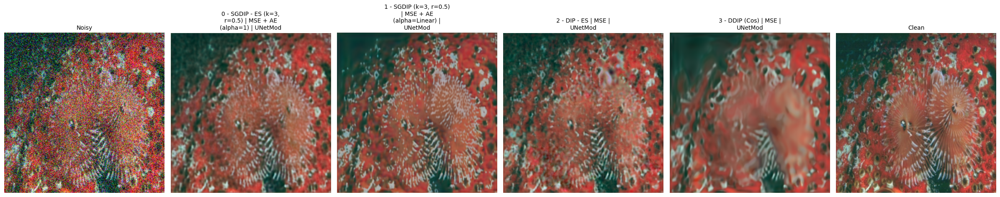

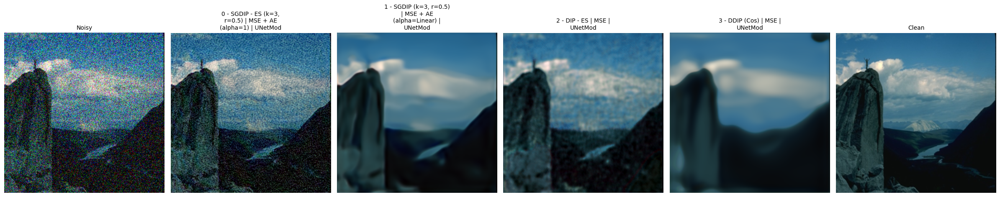

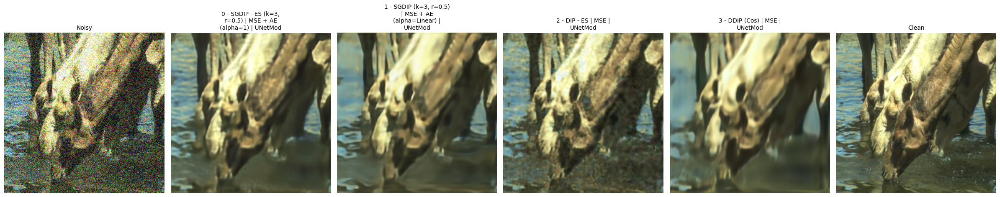

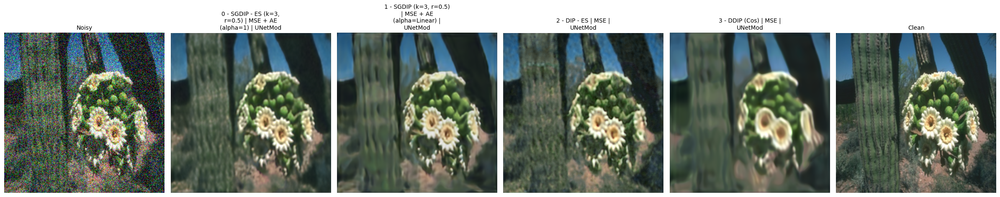

...

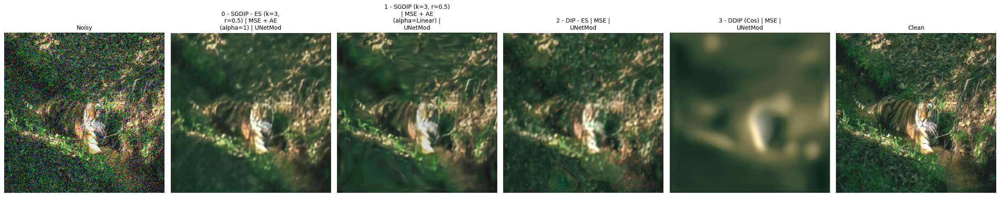

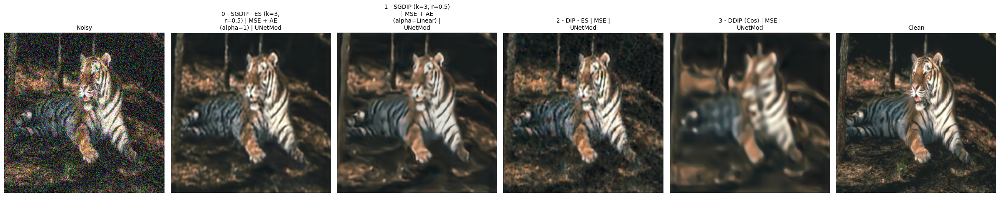

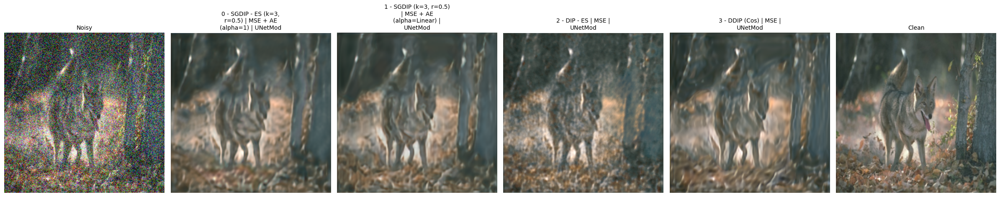

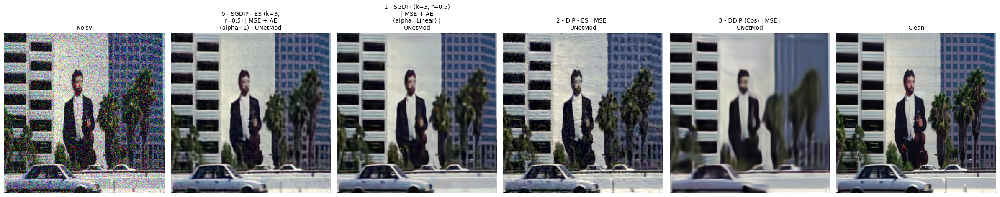

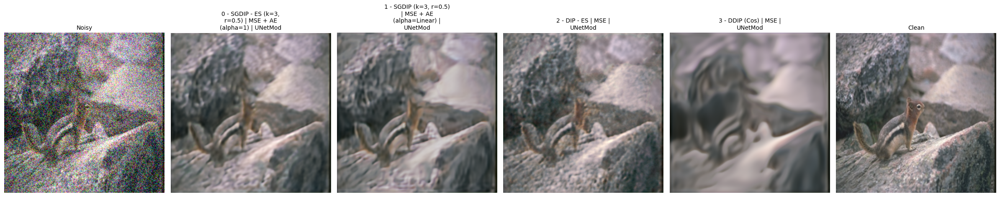

In [6]:
for result in zip(noisy, *results.values(), clean):
    utils.plot_row(result, ["Noisy", *list(results.keys()), "Clean"])

In [7]:
metrics = {
    "PSNR": PeakSignalNoiseRatio(data_range=2, reduction=None, dim=[1, 2, 3]),
    "SSIM": StructuralSimilarityIndexMeasure(data_range=2, reduction=None),
    # "LPIPS": LearnedPerceptualImagePatchSimilarity(),
}

for key, metric in metrics.items():
	print(key)
	print("----------")
	print(f"Noisy:".ljust(60), f"{metric(noisy, clean).mean()}")
	for name, xs in results.items():
		s = metric(xs, clean)
		print(f"{name}:".ljust(60), f"{s.mean()} ({s.var()})\t{s.tolist()}")
	print("\n")

PSNR
----------
Noisy:                                                       14.997001647949219
0 - SGDIP - ES (k=3, r=0.5) | MSE + AE (alpha=1) | UNetMod : 26.073938369750977 (6.285782814025879)	[33.37104797363281, 25.143491744995117, 22.0203800201416, 25.84168815612793, 25.825679779052734, 26.547561645507812, 24.490692138671875, 22.65762710571289, 24.34202003479004, 27.457345962524414, 26.705324172973633, 27.31296730041504, 25.476457595825195, 30.259403228759766, 24.78997039794922, 23.596315383911133, 26.294660568237305, 26.9454345703125, 25.48702621459961, 26.913625717163086]
1 - SGDIP (k=3, r=0.5) | MSE + AE (alpha=Linear) | UNetMod : 26.82562828063965 (5.96774959564209)	[34.06985855102539, 24.801666259765625, 30.385604858398438, 26.103954315185547, 26.40921974182129, 26.795108795166016, 25.230512619018555, 23.548505783081055, 24.665767669677734, 27.20728874206543, 27.073389053344727, 27.923404693603516, 25.095977783203125, 30.17695426940918, 25.503360748291016, 24.142126083374023,